In [6]:
import networkx as nx 
import numpy as np 
import pandas as pd
import json 
import requests 
import matplotlib.pyplot as plt 
import seaborn as sns

# import geopandas as gpd
from funcs import * 
import osmnx as ox

## Loading and retrieving real charging station locations

In [7]:
# Load json data into dataframe
df = pd.read_json('data/poi.json', lines = True)

In [8]:
# Data container
myDict = {

}

# Iterate and retrieve charging station addresses
for i in range(len(df['AddressInfo'])):
    data = df['AddressInfo'][i]
    myDict[i] = data


# Retrieve those that are fast charging
keep = []
for i in range(len(df['Connections'])):
    try:
        # If charging station is supercharger, disregard and check next connection
        # This removes Tesla proprietary chargers
        if 'supercharger' in df['Connections'][i][0]['ConnectionType']['Title'].lower():
            continue

        # Keep station if station is fast charge capable
        if df['Connections'][i][0]['Level']['IsFastChargeCapable']:
            keep.append(i)

    except:
        pass

# Find entries to delete
delete = [key for key,val in myDict.items() if val['Country']['Title'] != 'Norway']

# Delete entries not in Norway
for key in delete: del myDict[key]

# Keep only fast chargers
delete = [key for key in myDict if key not in keep]
for key in delete: del myDict[key]


In [9]:
# Store coordinates in separate lists
locs_x = [val['Longitude'] for key, val in myDict.items()]
locs_y = [val['Latitude'] for key, val in myDict.items()]

# Remove cordinates outsied of bound
locs_x = [x for x in locs_x if x > 0]
locs_y = [y for y in locs_y if y > 56]

# Create tuple list of locations
coords = list(zip(locs_x, locs_y))

In [10]:
len(coords)

810

In [11]:
# Plot locations
plt.figure(figsize = (10,10))
plt.scatter(x = locs_x, y = locs_y, s = 1.5)
plt.close()

## Load and analyze data on graph

In [12]:
G = nx.read_gpickle("data/BaseGraph03_NOR_wagrades.pickle")
labels = {n[1]:n[0] for n in enumerate(G.nodes)}

G = nx.relabel_nodes(G, labels)

In [13]:
cs = ox.get_nearest_nodes(G, locs_x, locs_y)

In [14]:
len(G.nodes)

18183

In [15]:
len(G.edges)

26324

In [16]:
len(set(cs))

461

## Create color and size map of currently existing charging stations


In [17]:
color_map = []
size_map = []
for i in G.nodes:
    if i in cs:
        color_map.append('blue')
        size_map.append(5)
    else:
        color_map.append('blue')
        size_map.append(0)

In [18]:
pos = get_inverted_latlon(G)


fig, (ax1, ax2)  = plt.subplots(1,2, figsize = (25,14))
ax1.scatter(x = locs_x, y = locs_y, s = 1.5)
ax1.axis("off")
ax2 = nx.draw(G, ax = ax2, pos = pos, node_size=size_map, node_color = color_map)
plt.savefig('figures/current_system.png', dpi = 400, bbox_inches = 'tight')
plt.close()

## Which vertices are not covered by 20, 30 and 40 kWh range?

In [19]:
from scipy import sparse
ranges = [20,30,40]


# For each range, load the reachability graph
# This one takes a while...
Q = set(G.nodes)
list_of_dicts = []
for r in ranges:
    # print(r)
    A = sparse.load_npz('data/Reachability_03_{}kwh_UNDIRECTED.npz'.format(r))
    coverage = {n:0 for n in Q}

    # For each vertex, retrieve the neighborhood
    for v in Q:
        a = A[:,v]
        nbrs = a.nonzero()[0]

        cov = set(nbrs).intersection(cs)
        coverage[v] = len(cov)

    list_of_dicts.append(coverage)

## Plot number of neighbors in range for each reachability threshold

In [20]:
from matplotlib import cm
import matplotlib as mpl

pos = get_inverted_latlon(G)
cmap = plt.cm.get_cmap('RdYlGn')

i = 0
r = 20
for l in list_of_dicts:
    coverage = list_of_dicts[i]

    nx.set_node_attributes(G, coverage, 'intsec')

    values = [v for k,v in coverage.items()]
    vertices = [k for k,v in coverage.items()]

    vmin, vmax = min(values), max(values)
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min(values), vmax=max(values)))
    sm.set_array([])
    fig.colorbar(sm)


    fig, ax = plt.subplots(figsize = (10,10))
    ax = nx.draw(G, pos, vmin=min(values), node_size = 1.5, node_color = values, vmax=4, cmap = plt.cm.get_cmap('RdYlGn'))
    plt.colorbar(sm)

    plt.savefig('figures/{}kwh_coverage.png'.format(r), dpi = 400, bbox_inches = 'tight')
    plt.close()
    i += 1
    r += 10

## Compute cost to nearest charging station

In [21]:
# This code performs Dijkstra search until it reaches a charging station, and may take a while to compute
# Patience...
Q = set(G.nodes)
costs_all = []
length = len(Q)
counter = 0
for i in G.nodes:
    counter += 1
    print(counter/length)
    cost = compute_required_reach(G, Q, i, cs)
    costs_all.append(cost)

9473134246
0.985480943738657
0.9855359401638893
0.9855909365891217
0.9856459330143541
0.9857009294395864
0.9857559258648187
0.9858109222900512
0.9858659187152835
0.9859209151405158
0.9859759115657483
0.9860309079909806
0.9860859044162129
0.9861409008414453
0.9861958972666777
0.98625089369191
0.9863058901171424
0.9863608865423747
0.9864158829676071
0.9864708793928395
0.9865258758180718
0.9865808722433042
0.9866358686685366
0.9866908650937689
0.9867458615190012
0.9868008579442337
0.986855854369466
0.9869108507946983
0.9869658472199307
0.9870208436451631
0.9870758400703954
0.9871308364956278
0.9871858329208602
0.9872408293460925
0.9872958257713249
0.9873508221965572
0.9874058186217896
0.987460815047022
0.9875158114722543
0.9875708078974866
0.9876258043227191
0.9876808007479514
0.9877357971731837
0.9877907935984162
0.9878457900236485
0.9879007864488808
0.9879557828741132
0.9880107792993456
0.9880657757245779
0.9881207721498103
0.9881757685750426
0.988230765000275
0.9882857614255074
0.98834

In [22]:
print("Minimum closest kwh distance to charging station:\t",round(min(costs_all),4))
print("Mean closest kwh distance to charging station:\t\t",round(np.mean(costs_all),3))
print("Median closest kwh distance to charging station:\t",round(np.median(costs_all),3))
print("Maximum clostest kwh distance to charging station:\t",round(max(costs_all),3))
print("Standard deviation\t\t\t\t\t",round(np.std(costs_all),3))
print("\nComputed using Dijkstra search from each node, and retrieving the closest charging station available from each node")

Minimum closest kwh distance to charging station:	 0.0002
Mean closest kwh distance to charging station:		 4.037
Median closest kwh distance to charging station:	 1.306
Maximum clostest kwh distance to charging station:	 98.811
Standard deviation					 7.304

Computed using Dijkstra search from each node, and retrieving the closest charging station available from each node


In [23]:
plt.figure(figsize = (15,10))
sns.histplot(costs_all, kde = True, fill = True)
plt.tick_params(axis='both', which='major', labelsize=15)
plt.xlabel('kWh consumption to nearest charging station' , fontsize = 15)
plt.ylabel('Number of vertices' , rotation = 90, fontsize = 15)
plt.xlim((-1, max(costs_all)))
plt.savefig('figures/distance_distribution_current_system.png', dpi = 400, bbox_inches = 'tight')
plt.close()

## Plot current system distances to nearest charging station

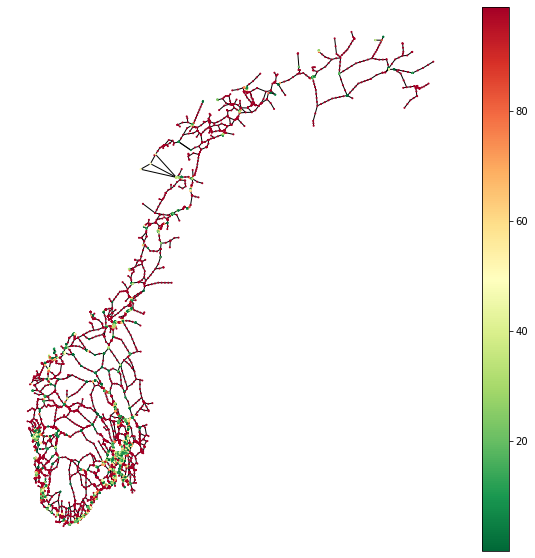

In [24]:
# Plot distance to charging stations with heatmap
from matplotlib import cm
import matplotlib as mpl

cmap = plt.cm.get_cmap('RdYlGn_r')

values = costs_all
vertices = [v for v in G.nodes]

vmin, vmax = min(values), max(values)
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min(values), vmax=max(values)))
sm.set_array([])
fig.colorbar(sm)


fig, ax = plt.subplots(figsize = (10,10))
ax = nx.draw(G, pos, vmin=min(values), node_size = 1, node_color = values, vmax=4, cmap = cmap)
plt.colorbar(sm)

plt.savefig('figures/distances_current_system.png', dpi = 400, bbox_inches = 'tight')
plt.show()

## Calculate ranges for current system and range

In [25]:
distances = pd.DataFrame(columns = ['category','Mean dist.', 'Median dist.', 'Min dist.', 'Max dist.'])
nbrs = pd.DataFrame(columns = ['category', 'Mean nbrs.', 'Median nbrs.', 'Min nbrs.', 'Max nbrs.', 'St.dev.'])

In [26]:
# Translate cs to enumerated (for adj. matrix)
dict_map = {n[0]:n[1] for n in enumerate(G.nodes)}

cs2 = [n[0] for n in dict_map.items() if n[1] in cs]

In [27]:
len(cs2)

461

In [28]:
# For each range, compute statistics
ranges = [20,30,40]

# Instantiate sets of global data collectors
dists = []
neighbors = []

to_iterate = [n[0] for n in enumerate(G.nodes) if n[0] not in cs2]
for r in ranges:
    A = scipy.sparse.load_npz('data/Reachability_03_{}kwh_UNDIRECTED.npz'.format(r))

    # Statistics of sets:
    all_dists = []
    n_neighbors = []

    # For each row, compute:
    for i in to_iterate:
        a = A[i,list(cs2)]
        a_data = a.data

        # Store distance data
        for i in a_data:
            all_dists.append(i)

        # Store neighbor a_data
        n = len(a_data)
        n_neighbors.append(n)
    
    # Append to full collection
    dists.append(all_dists)
    neighbors.append(n_neighbors)
    counter += 1

In [29]:
# Map distances to each category
distances['category'] = ['20kWh baseline', '30kWh baseline', '40kWh baseline']
distances['Mean dist.'] = [round(np.mean(i), 3) for i in dists]
distances['Median dist.'] = [round(np.median(i),3) for i in dists]
distances['Max dist.'] = [round(np.max(i),3) for i in dists]
distances['Min dist.'] = [round(np.min(i),4) for i in dists]

# Map n neighbors to each category
nbrs['category'] = ['20kWh baseline', '30kWh baseline', '40kWh baseline']
nbrs['Mean nbrs.'] = [round(np.mean(i),3) for i in neighbors]
nbrs['Median nbrs.'] = [int(np.median(i)) for i in neighbors]
nbrs['Min nbrs.'] = [np.min(i) for i in neighbors]
nbrs['Max nbrs.'] = [np.max(i) for i in neighbors]
nbrs['St.dev.'] = [round(np.std(i),3) for i in neighbors]

In [30]:
print(distances.to_latex(index = False))

\begin{tabular}{lrrrr}
\toprule
      category &  Mean dist. &  Median dist. &  Min dist. &  Max dist. \\
\midrule
20kWh baseline &      11.009 &        11.306 &      0.002 &       20.0 \\
30kWh baseline &      16.841 &        17.556 &      0.002 &       30.0 \\
40kWh baseline &      22.261 &        23.286 &      0.002 &       40.0 \\
\bottomrule
\end{tabular}



In [31]:
print(nbrs.to_latex(index = False))

\begin{tabular}{lrrrrr}
\toprule
      category &  Mean nbrs. &  Median nbrs. &  Min nbrs. &  Max nbrs. &  St.dev. \\
\midrule
20kWh baseline &      21.219 &            12 &          0 &         86 &   24.084 \\
30kWh baseline &      36.047 &            18 &          0 &        118 &   37.538 \\
40kWh baseline &      51.391 &            26 &          0 &        144 &   48.043 \\
\bottomrule
\end{tabular}



# Plot 2 dominating sets and compare them in one figure

In [45]:
import pickle
ConSets = pickle.load(open("data/ConnDomSets.pickle", "rb"))
DomSets = pickle.load(open("data/DomSets.pickle", "rb"))

In [46]:

Dk = DomSets[1] # Load 20, 2 set
Dc = ConSets[1]

In [47]:
print("Len Conn:\t",len(Dc))
print("Len reg:\t",len(Dk))

Len Conn:	 445
Len reg:	 914


In [48]:
# Create color and size map of charging stations

color_map = []
size_map = []
for i in G.nodes:
    if i in Dk:
        color_map.append('red')
        size_map.append(10)
    else:
        color_map.append('red')
        size_map.append(0)

color_map2 = []
size_map2 = []
for i in G.nodes:
    if i in Dc:
        color_map2.append('red')
        size_map2.append(10)
    else:
        color_map2.append('red')
        size_map2.append(0)

fig, (ax1, ax2)  = plt.subplots(1,2, figsize = (25,14))
ax1 = nx.draw(G, ax = ax1, pos = pos, node_color = color_map, node_size = size_map)
ax2 = nx.draw(G, ax = ax2, pos = pos, node_size=size_map2, node_color = color_map2)
plt.savefig("figures/kds_ckds_comparison.png", dpi = 400, bbox_inches = 'tight')
plt.close()

# Compare current system with connected k-dominating set

In [49]:
# range = 20, k = 2?? Minimal range with |D| closest to current number of charging stations 

In [50]:
import pickle
sets = pickle.load(open("data/ConnDomSets.pickle", "rb"))

D = sets[1] # Load 20, 2 set

In [51]:
D2 = set(cs)

In [52]:
# Create color and size map of charging stations

color_map = []
size_map = []
for i in G.nodes:
    if i in D:
        color_map.append('red')
        size_map.append(10)
    else:
        color_map.append('blue')
        size_map.append(0)

color_map2 = []
size_map2 = []
for i in G.nodes:
    if i in cs:
        color_map2.append('blue')
        size_map2.append(10)
    else:
        color_map2.append('red')
        size_map2.append(0)

fig, (ax1, ax2)  = plt.subplots(1,2, figsize = (25,14))
ax1 = nx.draw(G, ax = ax1, pos = pos, node_color = color_map, node_size = size_map)
ax2 = nx.draw(G, ax = ax2, pos = pos, node_size=size_map2, node_color = color_map2)

plt.savefig('figures/ckds_current_comparison.png', dpi = 400, bbox_inches = 'tight')
plt.close()

In [53]:
color_map = []
size_map = []

for i in G.nodes:
    if i in D:
        if i in D.intersection(D2):
            color_map.append('blue')
            size_map.append(10)
            continue
        color_map.append('red')
        size_map.append(10)
    else:
        color_map.append('blue')
        size_map.append(0)
    


plt.figure(figsize = (10,10))
nx.draw(G, pos = pos, node_color = color_map, node_size = size_map)
plt.savefig('figures\ckds_current_intersection.png', dpi = 400, bbox_inches = 'tight')
plt.close()

In [54]:
len(D.intersection(D2))

22

In [55]:
source = ox.get_nearest_node(G, (59.9139, 10.7522))
target = ox.get_nearest_node(G, (63.4305, 10.3951))
path = nx.shortest_path(G, source, target, weight = 'length')

In [56]:
path_edges = list(zip(path,path[1:]))

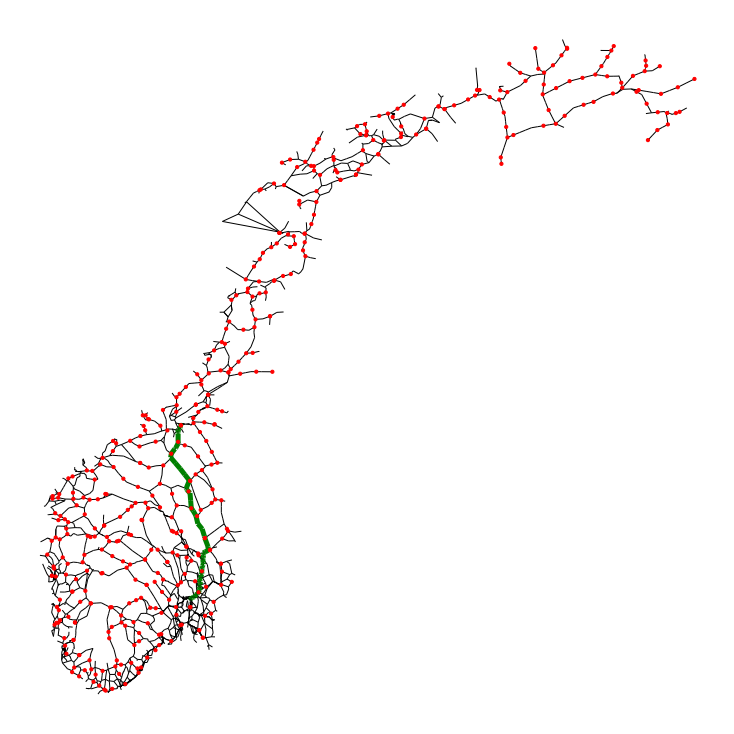

In [58]:
pos = get_inverted_latlon(G)

color_map = []
size_map = []

for i in G.nodes:
    if i in D:
        color_map.append('red')
        size_map.append(10)
    else:
        color_map.append('blue')
        size_map.append(0)


plt.figure(figsize = (10,10))
nx.draw(G,pos,node_color=color_map, node_size = size_map)
nx.draw_networkx_edges(G,pos,edgelist=path_edges,edge_color='green',width=5)
plt.show()